In [1]:
import pickle
import datasets
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

import numpy as np
import sys
sys.path.append('../')
import data_handler
import wandb
import pandas as pd

/n/home07/sangwonjung/.local/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
def load_config():
    api = wandb.Api()
    runs = api.runs('sangwonjung-Harvard University/mpr_generative')
    summary_list, config_list, name_list = [], [], []
    for run in runs:
        # .summary contains the output keys/values for metrics like accuracy.
        #  We call ._json_dict to omit large files 
        if run.state != 'finished':
            continue
        
        summary_list.append(run.summary._json_dict)
        # .config contains the hyperparameters.
        #  We remove special values that start with _.
        config_list.append(
            {k: v for k,v in run.config.items()
                if not k.startswith('_')})

        # .name is the human-readable name of the run.
        name_list.append({"id":run.id})

    summary_list = pd.DataFrame(summary_list)
    config_list = pd.DataFrame(config_list)
    name_list = pd.DataFrame(name_list)

    runs_df = pd.concat([name_list, config_list, summary_list], 
                        keys=["id", "config", "summary"], axis=1)
    return runs_df

In [3]:
def filter_results_df(df, config):
    def is_config_match(row_config, target_config):
        for key, value in target_config.items():
            if key in row_config.keys():
                if row_config[key] != value:
                    return False
            else:
                continue
        return True

    # Apply the function row-wise
    matches = df['config'].apply(is_config_match, axis=1, args=(config,))
    filtered_df = df[matches]
    print(f"Found {len(filtered_df)} matching runs")
    return filtered_df

In [4]:
def extract_filename(df, param_name=None, params=None):
    if param_name is not None:
        if param_name not in df['config'].columns:
            raise ValueError(f"param_name {param_name} not in config columns")
        filename_dic = {}
        for param in params:
            idx = df['config'].query(f'{param_name} == {param}').index
            if idx.empty:
                print(f"{param_name} {param} not found in the dataframe")
                continue
            elif idx.shape[0] > 1:
                print(f"{param_name} {param} found {idx.shape[0]} runs in the dataframe")
                print(f"Using the last one")
                idx = idx[-1:]
            _run = df.loc[idx]
            date, time = _run['config']['date'].iloc[0], _run['config']['time'].iloc[0]
            _id = _run['id']['id'].iloc[0]
            filename = f'{date}/{time}_{_id}'
            filename_dic[param] = filename
    else:
        filename_dic = {}
        for idx, _run in df.iterrows():
            date, time = _run['config']['date'], _run['config']['time']
            _id = _run['id']['id']
            filename = f'{date}/{time}_{_id}'
            filename_dic[idx] = filename
    return filename_dic

In [5]:
group_name = {
    ('gender',) : 'g',
    ('race',) : 'r',
    ('gender','age',) : 'ga',
    ('gender','age','race',) : 'gar'
}
color_palettes = {
    'g': plt.cm.Blues,  # Blue color palette for 'dt'
    'ga': plt.cm.Oranges,  # Orange color palette for 'linear'
    'gar': plt.cm.Greens  # Orange color palette for 'linear'
}

# Check MPRs with the number of generated samples

## SD_14

In [29]:
config = {
    'date' : '071924',
    'query_dataset' : 'general',
    'target_model' : 'SD_14',
    # 'target_profession' : 'firefighter', 
    # 'group' : ['gender','age','race'],
    'retrieve':False,
}
function_classes = ['linear','dt']
groups = [['gender'], ['race'], ['gender','age'],['gender','age','race']]
pool_sizes = [10,20,50,100,200,500,1000,2000,5000,10000,15000,18000,21000]
pool_sizes = [float(i) for i in pool_sizes]
MPR_results = {}
for fc in function_classes:
    config['functionclass'] = fc    
    MPR_results[fc] = {}
    for group in groups:
        config['mpr_group'] = group
        MPR_results[fc][tuple(group)] = {}
        for profession in ['firefighter','CEO']:
            print(f'Loading {fc} {group} {profession}')
            config['target_profession'] = profession
            MPR_results[fc][tuple(group)][profession] = {}

            runs_df = load_config()
            df = filter_results_df(runs_df, config)

            param_name = 'pool_size'
            # print(df['config']['pool_size'])
            filename_dic = extract_filename(df, param_name, pool_sizes)

            for param, filename in filename_dic.items():
                with open(filename+'_MPR.pkl', 'rb') as f:
                    print(f'{filename} is loaded for the result of {param_name} = {param}')
                    MPR_results[fc][tuple(group)][profession][param] = pickle.load(f)[profession]
    # with open(filename+'_score.pkl', 'rb') as f:
        # scores[param] = pickle.load(f)
    # with open(filename+'_idx.pkl', 'rb') as f:
        # idxs[param] = pickle.load(f)
# print(df['id']['id'].tolist())

Loading linear ['gender'] firefighter
Found 14 matching runs
pool_size 10.0 found 2 runs in the dataframe
Using the last one
071924/1510_of2afk1t is loaded for the result of pool_size = 10.0
071924/1210_uq2i85s7 is loaded for the result of pool_size = 20.0
071924/1215_vbmdn32m is loaded for the result of pool_size = 50.0
071924/1220_sve4dvj3 is loaded for the result of pool_size = 100.0
071924/1226_4ktos4oh is loaded for the result of pool_size = 200.0
071924/1231_k5jrvjk6 is loaded for the result of pool_size = 500.0
071924/1236_41q16ar1 is loaded for the result of pool_size = 1000.0
071924/1242_9wws8ypk is loaded for the result of pool_size = 2000.0
071924/1247_hw65bd8m is loaded for the result of pool_size = 5000.0
071924/1253_1woryw74 is loaded for the result of pool_size = 10000.0
071924/1429_u59bg2pe is loaded for the result of pool_size = 15000.0
071924/1303_02m2u3pl is loaded for the result of pool_size = 18000.0
071924/1309_z4h2cp3j is loaded for the result of pool_size = 2100

[1.56631202e-01 1.25077754e-01 1.27833225e-01 7.01807191e-02
 5.14241621e-02 2.35279503e-02 1.75800392e-02 1.31602094e-02
 6.55373685e-03 3.75352871e-03 2.97956828e-03 1.70351046e-03
 1.51685342e-16]
[1.68635811e-01 1.17085705e-01 1.16483507e-01 6.73734036e-02
 5.21005837e-02 2.61009499e-02 1.66951015e-02 1.25623836e-02
 7.15457495e-03 4.36112324e-03 3.38304876e-03 2.01095679e-03
 4.83085242e-16]
[2.07585414e-01 1.63581694e-01 1.11157404e-01 6.87935550e-02
 5.69308297e-02 3.32953318e-02 2.05389864e-02 1.27894601e-02
 8.78252837e-03 5.67311121e-03 3.57647471e-03 2.37302535e-03
 4.83085242e-16]
[2.64826988e-01 1.53550571e-01 1.18193814e-01 7.05533683e-02
 5.26117858e-02 2.58240198e-02 1.88959725e-02 1.52356308e-02
 7.04628507e-03 5.85693132e-03 3.75073195e-03 2.55827016e-03
 2.22044605e-16]
[2.85562844e-01 1.67750829e-01 1.24590277e-01 7.00005022e-02
 5.23212101e-02 3.62668022e-02 2.59351933e-02 1.81492359e-02
 7.86310043e-03 6.83952538e-03 4.13971979e-03 2.85680082e-03
 1.98602732e-16]


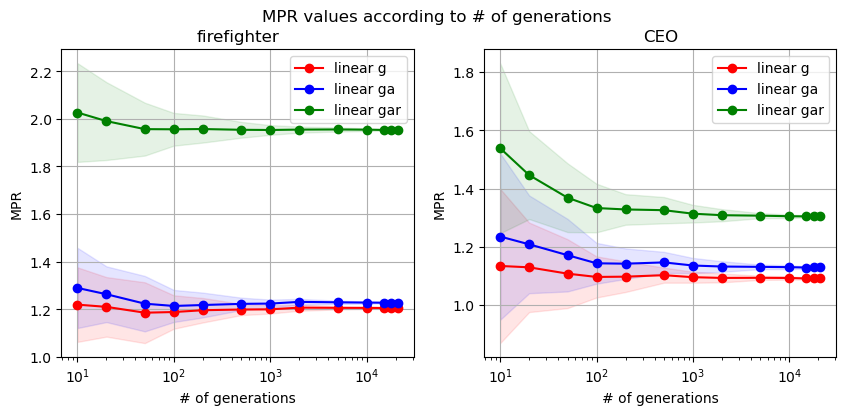

In [31]:
groups = [['gender'],  ['gender','age'],['gender','age','race']]
distinct_colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
fig, axes = plt.subplots(1,2, figsize=(10, 4))  # Set the figure size
for i, profession in enumerate(['firefighter','CEO']):
    for fc in function_classes:
        if fc == 'dt':
            continue
        config['functionclass'] = fc    
        # cmap = color_palettes[fc]
        for j, group in enumerate(groups):
            config['group'] = group
            # color_intensity = (j + 1) / len(groups)
            # color = cmap(color_intensity)
            color = distinct_colors[j % len(distinct_colors)]
            label = f'{fc} {group_name[tuple(group)]}'
            x = MPR_results[fc][tuple(group)][profession].keys()
            # y = MPR_results[fc][tuple(group)][profession].values()
            y = [np.array(i) for i in MPR_results[fc][tuple(group)][profession].values()]
            y = np.array(y)
            mean_mpr = np.mean(y, axis=1)
            var_mpr = np.var(y, axis=1)
            std_mpr = np.sqrt(var_mpr)
            print(std_mpr)
            axes[i].fill_between(x, mean_mpr - std_mpr, mean_mpr + std_mpr, alpha=0.1, color=color)
            axes[i].plot(x, mean_mpr, marker='o', label=label, color=color)  # Plot Pool Size vs. MPR
    axes[i].set_title(profession)  # Add a title
    axes[i].set_xlabel('# of generations')  # Label the x-axis
    axes[i].set_ylabel('MPR')  # Label the yaxis
    axes[i].grid(True)  # Add a grid
    axes[i].legend()
    axes[i].set_xscale('log')
    # axes[i].set_ylim(0.3,0.7)
fig.suptitle('MPR values according to # of generations')  # Add a title
fig.show()  # Display the plots

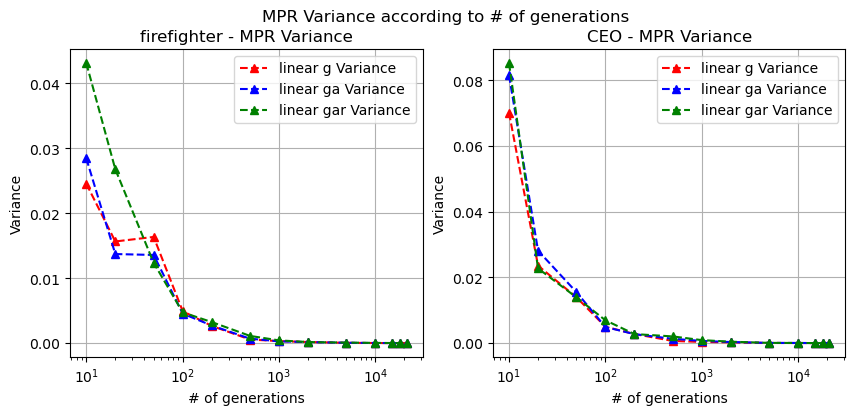

In [33]:
import numpy as np
import matplotlib.pyplot as plt

# Assuming the continuation of your setup with groups, distinct_colors, and MPR_results
fig, axes = plt.subplots(1, 2, figsize=(10, 4))  # Set the figure size
for i, profession in enumerate(['firefighter', 'CEO']):
    for fc in function_classes:
        if fc == 'dt':
            continue
        config['functionclass'] = fc
        for j, group in enumerate(groups):
            config['group'] = group
            color = distinct_colors[j % len(distinct_colors)]
            label = f'{fc} {group_name[tuple(group)]} Variance'
            x = list(MPR_results[fc][tuple(group)][profession].keys())
            y = [np.array(i) for i in MPR_results[fc][tuple(group)][profession].values()]
            y = np.array(y)
            var_mpr = np.var(y, axis=1)  # Calculate variance
            new_var_mpr = np.zeros(len(var_mpr))
            for k, n in enumerate(x):
                new_var_mpr[k] = var_mpr[k] 

            # Plot variance directly
            axes[i].plot(x, new_var_mpr, marker='^', linestyle='--', label=label, color=color)

    axes[i].set_title(f'{profession} - MPR Variance')
    axes[i].set_xlabel('# of generations')
    axes[i].set_ylabel('Variance')
    axes[i].set_xscale('log')
    # axes[i].set_yscale('log')
    axes[i].grid(True)
    axes[i].legend()

fig.suptitle('MPR Variance according to # of generations')
fig.show()

## SD_2 & SDXL

In [35]:
config = {
    'date' : '071924',
    'query_dataset' : 'general',
    'target_model' : 'SD_2',
    # 'target_profession' : 'firefighter', 
    # 'group' : ['gender','age','race'],
    'retrieve':False,
}
function_classes = ['linear','dt']
groups = [['gender','age','race']]
pool_sizes = [10,20,50,100,200,500,1000,2000,5000,10000,15000,18000,21000]
pool_sizes = [float(i) for i in pool_sizes]
MPR_SD2_results = {}
for fc in function_classes:
    config['functionclass'] = fc
    MPR_SD2_results[fc] = {}
    for group in groups:
        config['mpr_group'] = group
        MPR_SD2_results[fc][tuple(group)] = {}
        for profession in ['firefighter','CEO']:
            print(f'Loading {fc} {group} {profession}')
            config['target_profession'] = profession
            MPR_SD2_results[fc][tuple(group)][profession] = {}
            runs_df = load_config()
            df = filter_results_df(runs_df, config)

            param_name = 'pool_size'
            # print(df['config']['pool_size'])
            filename_dic = extract_filename(df, param_name, pool_sizes)

            for param, filename in filename_dic.items():
                with open(filename+'_MPR.pkl', 'rb') as f:
                    print(f'{filename} is loaded for the result of {param_name} = {param}')
                    MPR_SD2_results[fc][tuple(group)][profession][param] = pickle.load(f)[profession]
    # with open(filename+'_score.pkl', 'rb') as f:
        # scores[param] = pickle.load(f)
    # with open(filename+'_idx.pkl', 'rb') as f:
        # idxs[param] = pickle.load(f)
# print(df['id']['id'].tolist())

Loading linear ['gender', 'age', 'race'] firefighter
Found 13 matching runs
071924/1207_mt1518fh is loaded for the result of pool_size = 10.0
071924/1212_osa21rtk is loaded for the result of pool_size = 20.0
071924/1218_7u7q10eo is loaded for the result of pool_size = 50.0
071924/1223_7b6rjdhf is loaded for the result of pool_size = 100.0
071924/1228_30yqp1kq is loaded for the result of pool_size = 200.0
071924/1234_1vktwsv0 is loaded for the result of pool_size = 500.0
071924/1239_vfd11tp2 is loaded for the result of pool_size = 1000.0
071924/1245_juzx3619 is loaded for the result of pool_size = 2000.0
071924/1250_ti0hj9cb is loaded for the result of pool_size = 5000.0
071924/1438_qh4i7sde is loaded for the result of pool_size = 10000.0
071924/1301_ff8lgqrb is loaded for the result of pool_size = 15000.0
071924/1306_yiq5q3cv is loaded for the result of pool_size = 18000.0
071924/1311_qqnrd2ih is loaded for the result of pool_size = 21000.0
Loading linear ['gender', 'age', 'race'] CEO


In [36]:
config = {
    'date' : '071924',
    'query_dataset' : 'general',
    'target_model' : 'SDXL',
    # 'target_profession' : 'firefighter', 
    # 'group' : ['gender','age','race'],
    'retrieve':False,
}
function_classes = ['linear','dt']
groups = [['gender','age','race']]
pool_sizes = [10,20,50,100,200,500,1000,2000,5000,10000,15000,18000,21000]
pool_sizes = [float(i) for i in pool_sizes]
MPR_SDXL_results = {}
for fc in function_classes:
    config['functionclass'] = fc
    MPR_SDXL_results[fc] = {}
    for group in groups:
        config['mpr_group'] = group
        MPR_SDXL_results[fc][tuple(group)] = {}
        for profession in ['firefighter']:
            print(f'Loading {fc} {group} {profession}')
            config['target_profession'] = profession
            MPR_SDXL_results[fc][tuple(group)][profession] = {}

            runs_df = load_config()
            df = filter_results_df(runs_df, config)

            param_name = 'pool_size'
            # print(df['config']['pool_size'])
            filename_dic = extract_filename(df, param_name, pool_sizes)

            for param, filename in filename_dic.items():
                with open(filename+'_MPR.pkl', 'rb') as f:
                    print(f'{filename} is loaded for the result of {param_name} = {param}')
                    MPR_SDXL_results[fc][tuple(group)][profession][param] = pickle.load(f)[profession]
                with open(filename+'_score.pkl', 'rb') as f:
                    t = pickle.load(f)[profession]
                    # print(t/param)
                    # with open(filename+'_score.pkl', 'rb') as f:
                    # scores[param] = pickle.load(f)
    # with open(filename+'_idx.pkl', 'rb') as f:
        # idxs[param] = pickle.load(f)
# print(df['id']['id'].tolist())

Loading linear ['gender', 'age', 'race'] firefighter
Found 13 matching runs
071924/1206_skfue8e7 is loaded for the result of pool_size = 10.0
071924/1206_ou51z5v1 is loaded for the result of pool_size = 20.0
071924/1207_8sbfitd7 is loaded for the result of pool_size = 50.0
071924/1208_gr9yjslh is loaded for the result of pool_size = 100.0
071924/1208_d5c3zx25 is loaded for the result of pool_size = 200.0
071924/1209_dhvqzbww is loaded for the result of pool_size = 500.0
071924/1210_ca9bxydq is loaded for the result of pool_size = 1000.0
071924/1210_pr7cb06d is loaded for the result of pool_size = 2000.0
071924/1211_qzweuatp is loaded for the result of pool_size = 5000.0
071924/1212_gd8lkygf is loaded for the result of pool_size = 10000.0
071924/1212_23v3zvvk is loaded for the result of pool_size = 15000.0
071924/1213_0y9updw2 is loaded for the result of pool_size = 18000.0
071924/1214_asbis8nq is loaded for the result of pool_size = 21000.0
Loading dt ['gender', 'age', 'race'] firefigh

{'linear': {('gender', 'age', 'race'): {'firefighter': {10.0: [2.279205507011916, 2.2206706356054964, 2.279205507011916, 2.279205507011916, 2.0634148376678705, 2.279205507011916, 2.279205507011916, 2.2206706356054964, 2.279205507011916, 2.2206706356054964, 1.9485530977199519, 2.279205507011916, 1.9854444642329632, 2.279205507011916, 2.279205507011916, 2.279205507011916, 2.1262832510417935, 2.1262832510417935, 2.279205507011916, 2.279205507011916, 2.279205507011916, 2.132491100705979, 2.279205507011916, 2.279205507011916, 2.2206706356054964, 2.279205507011916, 2.279205507011916, 2.279205507011916, 2.279205507011916, 2.1246339275688957], 20.0: [2.279205507011916, 2.220670635605496, 2.1995292913319324, 2.2025321833952454, 2.0634148376678705, 2.279205507011916, 2.279205507011916, 2.245679831925509, 2.199529291331933, 2.245679831925509, 2.0187779101241983, 2.199529291331933, 2.123295488591586, 2.1987322562524847, 2.1625929001447615, 2.279205507011916, 2.1995292913319324, 2.1995292913319324,

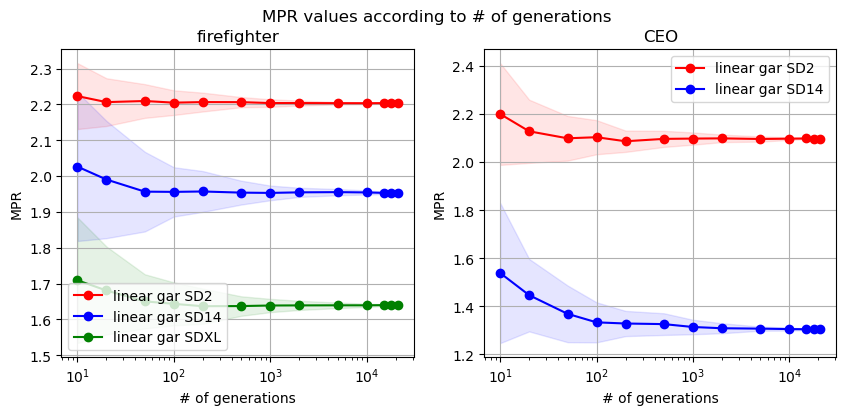

In [41]:
distinct_colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
groups = [['gender','age','race']]
fig, axes = plt.subplots(1,2, figsize=(10, 4))  # Set the figure size
results_dic = {
    'SD2': MPR_SD2_results,
    'SD14':MPR_results,
    'SDXL' : MPR_SDXL_results
}
for i, profession in enumerate(['firefighter','CEO']):
    for fc in function_classes:
        if fc == 'dt':
            continue
        config['functionclass'] = fc    
        # cmap = color_palettes[fc]
        for j, group in enumerate(groups):
            config['group'] = group
            # color_intensity = (j + 1) / len(groups)
            # color = cmap(color_intensity)
            
            for k, (model, results) in enumerate(results_dic.items()):
                print(results)
                label = f'{fc} {group_name[tuple(group)]} {model}'
                color = distinct_colors[k]
                if profession != 'firefighter' and model == 'SDXL':
                    continue
                x = list(results[fc][tuple(group)][profession].keys())
                y = [np.array(i) for i in results[fc][tuple(group)][profession].values()]
                y = np.array(y)
                mean_mpr = np.mean(y, axis=1)
                var_mpr = np.var(y, axis=1)
                std_mpr = np.sqrt(var_mpr)
                axes[i].fill_between(x, mean_mpr - std_mpr, mean_mpr + std_mpr, alpha=0.1, color=color)
                axes[i].plot(x, mean_mpr, marker='o', label=label, color=color)  # Plot Pool Size vs. MPR

            # axes[i].plot(MPR_SD2_results[fc][tuple(group)][profession].keys(), MPR_SD2_results[fc][tuple(group)][profession].values(),
            #  marker='o', linestyle='--',label=label+ ' SD v2', color=color)  # Plot Pool Size vs. MPR
            # axes[i].plot(MPR_results[fc][tuple(group)][profession].keys(), MPR_results[fc][tuple(group)][profession].values(),
            #  marker='o', label=label+' SD v1.4', color=color)  # Plot Pool Size vs. MPR            
            # if profession == 'firefighter':
                # axes[i].plot(MPR_SDXL_results[fc][tuple(group)][profession].keys(), MPR_SDXL_results[fc][tuple(group)][profession].values(),
                #  marker='o', linestyle='dotted',label=label+ ' SDXL', color=color)  # Plot Pool Size vs. MPR

    axes[i].set_title(profession)  # Add a title
    axes[i].set_xlabel('# of generations')  # Label the x-axis
    axes[i].set_ylabel('MPR')  # Label the yaxis
    axes[i].grid(True)  # Add a grid
    axes[i].legend()
    axes[i].set_xscale('log')
    # axes[i].set_ylim(0,1)
fig.suptitle('MPR values according to # of generations')  # Add a title
fig.show()  # Display the plots

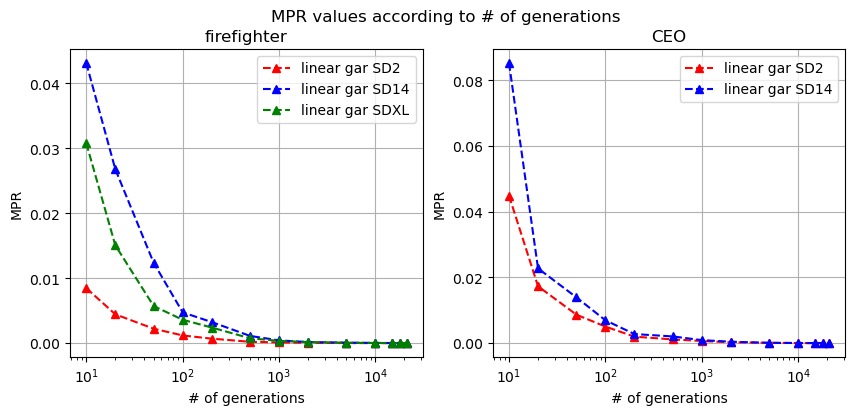

In [47]:
distinct_colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
groups = [['gender','age','race']]
fig, axes = plt.subplots(1,2, figsize=(10, 4))  # Set the figure size
results_dic = {
    'SD2': MPR_SD2_results,
    'SD14':MPR_results,
    'SDXL' : MPR_SDXL_results
}
for i, profession in enumerate(['firefighter','CEO']):
    for fc in function_classes:
        if fc == 'dt':
            continue
        config['functionclass'] = fc    
        # cmap = color_palettes[fc]
        for j, group in enumerate(groups):
            config['group'] = group
            # color_intensity = (j + 1) / len(groups)
            # color = cmap(color_intensity)
            
            for k, (model, results) in enumerate(results_dic.items()):
                label = f'{fc} {group_name[tuple(group)]} {model}'
                color = distinct_colors[k]
                if profession != 'firefighter' and model == 'SDXL':
                    continue
                x = list(results[fc][tuple(group)][profession].keys())
                y = [np.array(i) for i in results[fc][tuple(group)][profession].values()]
                y = np.array(y)
                mean_mpr = np.mean(y, axis=1)
                var_mpr = np.var(y, axis=1)
                std_mpr = np.sqrt(var_mpr)
                new_var_mpr = np.zeros(len(var_mpr))
                for k, n in enumerate(x):
                    new_var_mpr[k] = var_mpr[k]

                # Plot variance directly
                axes[i].plot(x, new_var_mpr, marker='^', linestyle='--', label=label, color=color)

            # axes[i].plot(MPR_SD2_results[fc][tuple(group)][profession].keys(), MPR_SD2_results[fc][tuple(group)][profession].values(),
            #  marker='o', linestyle='--',label=label+ ' SD v2', color=color)  # Plot Pool Size vs. MPR
            # axes[i].plot(MPR_results[fc][tuple(group)][profession].keys(), MPR_results[fc][tuple(group)][profession].values(),
            #  marker='o', label=label+' SD v1.4', color=color)  # Plot Pool Size vs. MPR            
            # if profession == 'firefighter':
                # axes[i].plot(MPR_SDXL_results[fc][tuple(group)][profession].keys(), MPR_SDXL_results[fc][tuple(group)][profession].values(),
                #  marker='o', linestyle='dotted',label=label+ ' SDXL', color=color)  # Plot Pool Size vs. MPR

    axes[i].set_title(profession)  # Add a title
    axes[i].set_xlabel('# of generations')  # Label the x-axis
    axes[i].set_ylabel('MPR')  # Label the yaxis
    axes[i].grid(True)  # Add a grid
    axes[i].legend()
    axes[i].set_xscale('log')
    # axes[i].set_ylim(0,1)
fig.suptitle('MPR values according to # of generations')  # Add a title
fig.show()  # Display the plots

## Ablation of use of adjective on prompts

In [13]:
config = {
    'date' : '0720',
    'query_dataset' : 'general',
    'target_model' : 'SD_14',
    'p_ver' : 'v2',
    # 'target_profession' : 'firefighter', 
    # 'group' : ['gender','age','race'],
    'retrieve':False,
}
function_classes = ['linear']
groups = [['gender','age','race']]
pool_sizes = [10,20,50,100,200,500,1000,2000,5000,10000,15000,18000,21000]
pool_sizes = [float(i) for i in pool_sizes]
MPR_results_noadj = {}
for fc in function_classes:
    config['functionclass'] = fc    
    MPR_results_noadj[fc] = {}
    for group in groups:
        config['mpr_group'] = group
        MPR_results_noadj[fc][tuple(group)] = {}
        for profession in ['firefighter','CEO']:
            print(f'Loading {fc} {group} {profession}')
            config['target_profession'] = profession
            MPR_results_noadj[fc][tuple(group)][profession] = {}

            runs_df = load_config()
            df = filter_results_df(runs_df, config)

            param_name = 'pool_size'
            # print(df['config']['pool_size'])
            filename_dic = extract_filename(df, param_name, pool_sizes)

            for param, filename in filename_dic.items():
                with open(filename+'_MPR.pkl', 'rb') as f:
                    print(f'{filename} is loaded for the result of {param_name} = {param}')
                    MPR_results_noadj[fc][tuple(group)][profession][param] = pickle.load(f)[profession]
    # with open(filename+'_score.pkl', 'rb') as f:
        # scores[param] = pickle.load(f)
    # with open(filename+'_idx.pkl', 'rb') as f:
        # idxs[param] = pickle.load(f)
# print(df['id']['id'].tolist())

Loading linear ['gender', 'age', 'race'] firefighter
Found 13 matching runs
0720/2325_hyokybdd is loaded for the result of pool_size = 10.0
0720/2331_4pmit7sd is loaded for the result of pool_size = 20.0
0720/2338_115axd9a is loaded for the result of pool_size = 50.0
0720/2344_dw34aq6p is loaded for the result of pool_size = 100.0
0720/2350_1d5y5tss is loaded for the result of pool_size = 200.0
0720/2356_nf2nx1ju is loaded for the result of pool_size = 500.0
0720/0002_ge7ndx7v is loaded for the result of pool_size = 1000.0
0720/0008_fg0jxu8a is loaded for the result of pool_size = 2000.0
0720/0014_x1hwmm61 is loaded for the result of pool_size = 5000.0
0720/0020_14vhswii is loaded for the result of pool_size = 10000.0
0720/0027_1kdi4pwc is loaded for the result of pool_size = 15000.0
0720/0033_m5nxuaqo is loaded for the result of pool_size = 18000.0
0720/0039_v1exfyhf is loaded for the result of pool_size = 21000.0
Loading linear ['gender', 'age', 'race'] CEO
Found 13 matching runs
072

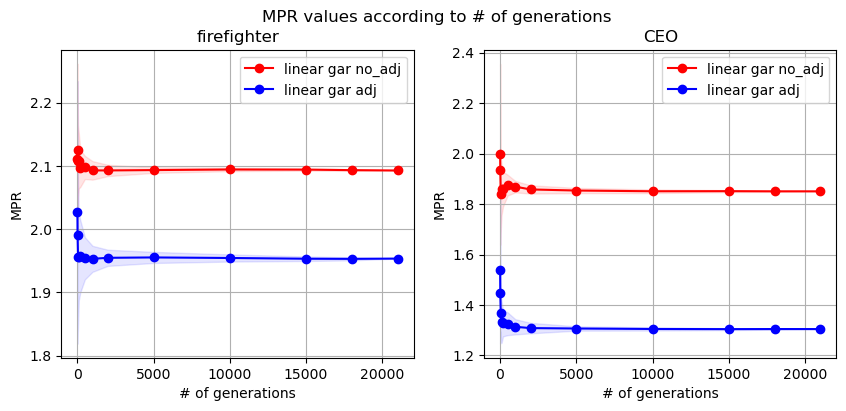

In [14]:
distinct_colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
groups = [['gender','age','race']]
fig, axes = plt.subplots(1,2, figsize=(10, 4))  # Set the figure size
results_dic = {
    'no_adj': MPR_results_noadj,
    'adj':MPR_results,
}
for i, profession in enumerate(['firefighter','CEO']):
    for fc in function_classes:
        if fc == 'dt':
            continue
        config['functionclass'] = fc    
        # cmap = color_palettes[fc]
        for j, group in enumerate(groups):
            config['group'] = group
            # color_intensity = (j + 1) / len(groups)
            # color = cmap(color_intensity)
            
            for k, (model, results) in enumerate(results_dic.items()):
                label = f'{fc} {group_name[tuple(group)]} {model}'
                color = distinct_colors[k]
                if profession != 'firefighter' and model == 'SDXL':
                    continue
                x = list(results[fc][tuple(group)][profession].keys())
                y = [np.array(i) for i in results[fc][tuple(group)][profession].values()]
                y = np.array(y)
                mean_mpr = np.mean(y, axis=1)
                var_mpr = np.var(y, axis=1)
                std_mpr = np.sqrt(var_mpr)
                axes[i].fill_between(x, mean_mpr - std_mpr, mean_mpr + std_mpr, alpha=0.1, color=color)
                axes[i].plot(x, mean_mpr, marker='o', label=label, color=color)  # Plot Pool Size vs. MPR

            # axes[i].plot(MPR_SD2_results[fc][tuple(group)][profession].keys(), MPR_SD2_results[fc][tuple(group)][profession].values(),
            #  marker='o', linestyle='--',label=label+ ' SD v2', color=color)  # Plot Pool Size vs. MPR
            # axes[i].plot(MPR_results[fc][tuple(group)][profession].keys(), MPR_results[fc][tuple(group)][profession].values(),
            #  marker='o', label=label+' SD v1.4', color=color)  # Plot Pool Size vs. MPR            
            # if profession == 'firefighter':
                # axes[i].plot(MPR_SDXL_results[fc][tuple(group)][profession].keys(), MPR_SDXL_results[fc][tuple(group)][profession].values(),
                #  marker='o', linestyle='dotted',label=label+ ' SDXL', color=color)  # Plot Pool Size vs. MPR

    axes[i].set_title(profession)  # Add a title
    axes[i].set_xlabel('# of generations')  # Label the x-axis
    axes[i].set_ylabel('MPR')  # Label the yaxis
    axes[i].grid(True)  # Add a grid
    axes[i].legend()
    # axes[i].set_xscale('log')
    # axes[i].set_ylim(0,1)
fig.suptitle('MPR values according to # of generations')  # Add a title
fig.show()  # Display the plots

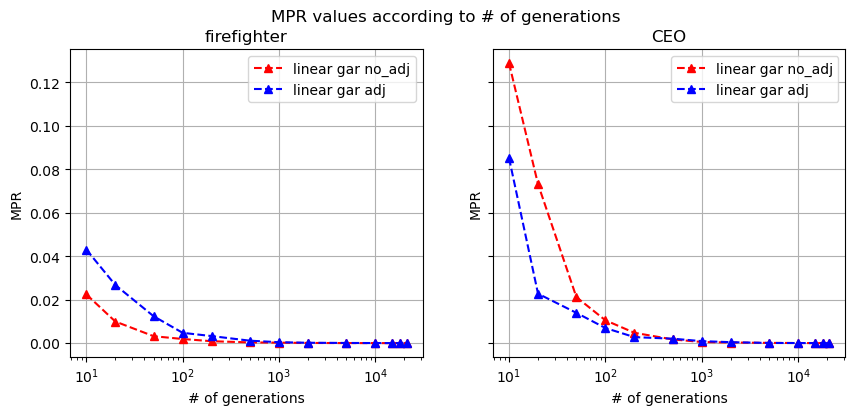

In [51]:
distinct_colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
groups = [['gender','age','race']]
fig, axes = plt.subplots(1,2, figsize=(10, 4), sharey=True)  # Set the figure size
results_dic = {
    'no_adj': MPR_results_noadj,
    'adj':MPR_results,
}
for i, profession in enumerate(['firefighter','CEO']):
    for fc in function_classes:
        if fc == 'dt':
            continue
        config['functionclass'] = fc    
        # cmap = color_palettes[fc]
        for j, group in enumerate(groups):
            config['group'] = group
            # color_intensity = (j + 1) / len(groups)
            # color = cmap(color_intensity)
            
            for k, (model, results) in enumerate(results_dic.items()):
                label = f'{fc} {group_name[tuple(group)]} {model}'
                color = distinct_colors[k]
                if profession != 'firefighter' and model == 'SDXL':
                    continue
                x = list(results[fc][tuple(group)][profession].keys())
                y = [np.array(i) for i in results[fc][tuple(group)][profession].values()]
                y = np.array(y)
                mean_mpr = np.mean(y, axis=1)
                var_mpr = np.var(y, axis=1)
                std_mpr = np.sqrt(var_mpr)
                new_var_mpr = np.zeros(len(var_mpr))
                for k, n in enumerate(x):
                    new_var_mpr[k] = var_mpr[k] 

                # Plot variance directly
                axes[i].plot(x, new_var_mpr, marker='^', linestyle='--', label=label, color=color)

            # axes[i].plot(MPR_SD2_results[fc][tuple(group)][profession].keys(), MPR_SD2_results[fc][tuple(group)][profession].values(),
            #  marker='o', linestyle='--',label=label+ ' SD v2', color=color)  # Plot Pool Size vs. MPR
            # axes[i].plot(MPR_results[fc][tuple(group)][profession].keys(), MPR_results[fc][tuple(group)][profession].values(),
            #  marker='o', label=label+' SD v1.4', color=color)  # Plot Pool Size vs. MPR            
            # if profession == 'firefighter':
                # axes[i].plot(MPR_SDXL_results[fc][tuple(group)][profession].keys(), MPR_SDXL_results[fc][tuple(group)][profession].values(),
                #  marker='o', linestyle='dotted',label=label+ ' SDXL', color=color)  # Plot Pool Size vs. MPR

    axes[i].set_title(profession)  # Add a title
    axes[i].set_xlabel('# of generations')  # Label the x-axis
    axes[i].set_ylabel('MPR')  # Label the yaxis
    axes[i].grid(True)  # Add a grid
    axes[i].legend()
    axes[i].set_xscale('log')
    # axes[i].set_ylim(0,1)
fig.suptitle('MPR values according to # of generations')  # Add a title
fig.show()  # Display the plots

## Boolean 2

In [53]:
config = {
    'date' : '071924',
    'query_dataset' : 'general',
    'target_model' : 'SD_14',
    # 'target_profession' : 'firefighter', 
    # 'group' : ['gender','age','race'],
    'retrieve':False,
}
function_classes = ['linear','boolean2']
groups = [['gender'], ['race'], ['gender','age'],['gender','age','race']]
pool_sizes = [10,20,50,100,200,500,1000,2000,5000,10000,15000,18000,21000]
pool_sizes = [float(i) for i in pool_sizes]
MPR_results = {}
for fc in function_classes:
    config['functionclass'] = fc    
    MPR_results[fc] = {}
    for group in groups:
        config['mpr_group'] = group
        MPR_results[fc][tuple(group)] = {}
        for profession in ['firefighter','CEO']:
            print(f'Loading {fc} {group} {profession}')
            config['target_profession'] = profession
            MPR_results[fc][tuple(group)][profession] = {}

            runs_df = load_config()
            df = filter_results_df(runs_df, config)

            param_name = 'pool_size'
            # print(df['config']['pool_size'])
            filename_dic = extract_filename(df, param_name, pool_sizes)

            for param, filename in filename_dic.items():
                with open(filename+'_MPR.pkl', 'rb') as f:
                    print(f'{filename} is loaded for the result of {param_name} = {param}')
                    MPR_results[fc][tuple(group)][profession][param] = pickle.load(f)[profession]
    # with open(filename+'_score.pkl', 'rb') as f:
        # scores[param] = pickle.load(f)
    # with open(filename+'_idx.pkl', 'rb') as f:
        # idxs[param] = pickle.load(f)
# print(df['id']['id'].tolist())

Loading linear ['gender'] firefighter
Found 14 matching runs
pool_size 10.0 found 2 runs in the dataframe
Using the last one
071924/1510_of2afk1t is loaded for the result of pool_size = 10.0
071924/1210_uq2i85s7 is loaded for the result of pool_size = 20.0
071924/1215_vbmdn32m is loaded for the result of pool_size = 50.0
071924/1220_sve4dvj3 is loaded for the result of pool_size = 100.0
071924/1226_4ktos4oh is loaded for the result of pool_size = 200.0
071924/1231_k5jrvjk6 is loaded for the result of pool_size = 500.0
071924/1236_41q16ar1 is loaded for the result of pool_size = 1000.0
071924/1242_9wws8ypk is loaded for the result of pool_size = 2000.0
071924/1247_hw65bd8m is loaded for the result of pool_size = 5000.0
071924/1253_1woryw74 is loaded for the result of pool_size = 10000.0
071924/1429_u59bg2pe is loaded for the result of pool_size = 15000.0
071924/1303_02m2u3pl is loaded for the result of pool_size = 18000.0
071924/1309_z4h2cp3j is loaded for the result of pool_size = 2100

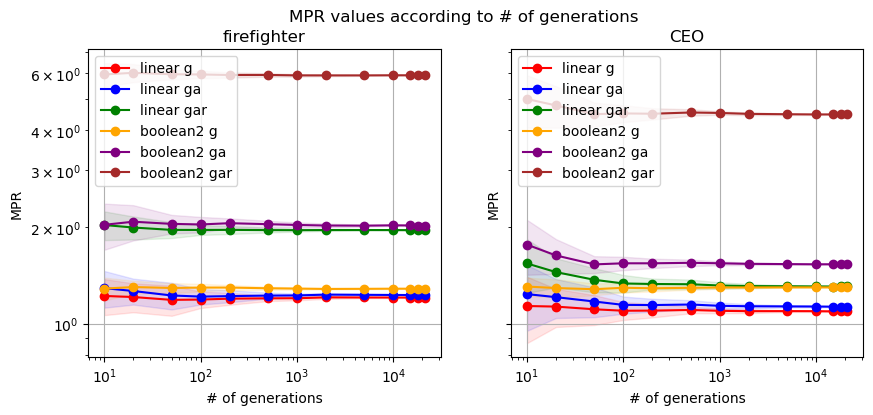

In [54]:
import matplotlib.colors as mcolors

groups = [['gender'],  ['gender','age'],['gender','age','race']]
distinct_colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
fig, axes = plt.subplots(1,2, figsize=(10, 4), sharey=True)  # Set the figure size
for i, profession in enumerate(['firefighter','CEO']):
    color_index = 0
    for k, fc in enumerate(function_classes):
        for j, group in enumerate(groups):
            color = distinct_colors[color_index % len(distinct_colors)]
            label = f'{fc} {group_name[tuple(group)]}'
            x = MPR_results[fc][tuple(group)][profession].keys()
            # y = MPR_results[fc][tuple(group)][profession].values()
            y = [np.array(i) for i in MPR_results[fc][tuple(group)][profession].values()]
            y = np.array(y)
            mean_mpr = np.mean(y, axis=1)
            var_mpr = np.var(y, axis=1)
            std_mpr = np.sqrt(var_mpr)
            axes[i].fill_between(x, mean_mpr - std_mpr, mean_mpr + std_mpr, alpha=0.1, color=color)
            axes[i].plot(x, mean_mpr, marker='o', label=label, color=color)  # Plot Pool Size vs. MPR
            color_index += 1
    axes[i].set_title(profession)  # Add a title
    axes[i].set_xlabel('# of generations')  # Label the x-axis
    axes[i].set_ylabel('MPR')  # Label the yaxis
    axes[i].grid(True)  # Add a grid
    axes[i].legend()
    axes[i].set_xscale('log')
    axes[i].set_yscale('log')
    # axes[i].set_ylim(0.3,0.7)
fig.suptitle('MPR values according to # of generations')  # Add a title
fig.show()  # Display the plots

In [ ]:
distinct_colors = ['red', 'blue', 'green', 'orange', 'purple', 'brown', 'pink', 'gray', 'olive', 'cyan']
groups = [['gender','age','race']]
fig, axes = plt.subplots(1,2, figsize=(10, 4))  # Set the figure size
results_dic = {
    'no_adj': MPR_results_noadj,
    'adj':MPR_results,
}
for i, profession in enumerate(['firefighter','CEO']):
    for fc in function_classes:
        if fc == 'dt':
            continue
        config['functionclass'] = fc    
        # cmap = color_palettes[fc]
        for j, group in enumerate(groups):
            config['group'] = group
            # color_intensity = (j + 1) / len(groups)
            # color = cmap(color_intensity)
            
            for k, (model, results) in enumerate(results_dic.items()):
                label = f'{fc} {group_name[tuple(group)]} {model}'
                color = distinct_colors[k]
                if profession != 'firefighter' and model == 'SDXL':
                    continue
                x = list(results[fc][tuple(group)][profession].keys())
                y = [np.array(i) for i in results[fc][tuple(group)][profession].values()]
                y = np.array(y)
                mean_mpr = np.mean(y, axis=1)
                var_mpr = np.var(y, axis=1)
                std_mpr = np.sqrt(var_mpr)
                new_var_mpr = np.zeros(len(var_mpr))
                for k, n in enumerate(x):
                    new_var_mpr[k] = var_mpr[k] 

                # Plot variance directly
                axes[i].plot(x, new_var_mpr, marker='^', linestyle='--', label=label, color=color)

            # axes[i].plot(MPR_SD2_results[fc][tuple(group)][profession].keys(), MPR_SD2_results[fc][tuple(group)][profession].values(),
            #  marker='o', linestyle='--',label=label+ ' SD v2', color=color)  # Plot Pool Size vs. MPR
            # axes[i].plot(MPR_results[fc][tuple(group)][profession].keys(), MPR_results[fc][tuple(group)][profession].values(),
            #  marker='o', label=label+' SD v1.4', color=color)  # Plot Pool Size vs. MPR            
            # if profession == 'firefighter':
                # axes[i].plot(MPR_SDXL_results[fc][tuple(group)][profession].keys(), MPR_SDXL_results[fc][tuple(group)][profession].values(),
                #  marker='o', linestyle='dotted',label=label+ ' SDXL', color=color)  # Plot Pool Size vs. MPR

    axes[i].set_title(profession)  # Add a title
    axes[i].set_xlabel('# of generations')  # Label the x-axis
    axes[i].set_ylabel('MPR')  # Label the yaxis
    axes[i].grid(True)  # Add a grid
    axes[i].legend()
    axes[i].set_xscale('log')
    # axes[i].set_ylim(0,1)
fig.suptitle('MPR values according to # of generations')  # Add a title
fig.show()  # Display the plots

## One hot vs soft group labels

In [16]:
config = {
    'date' : '071024_onehot',
    'query_dataset' : 'general',
    'target_model' : 'SD_14',
    # 'target_profession' : 'firefighter', 
    # 'group' : ['gender','age','race'],
    'retrieve':False,
}
function_classes = ['linear','dt']
groups = [['gender','age','race']]
pool_sizes = [10,20,50,100,200,500,1000,2000,5000,10000,15000,18000,21000]
pool_sizes = [float(i) for i in pool_sizes]
MPR_results_onehot = {}
for fc in function_classes:
    config['functionclass'] = fc    
    MPR_results_onehot[fc] = {}
    for group in groups:
        config['group'] = group
        MPR_results_onehot[fc][tuple(group)] = {}
        for profession in ['firefighter','CEO']:
            print(f'Loading {fc} {group} {profession}')
            config['target_profession'] = profession
            MPR_results_onehot[fc][tuple(group)][profession] = {}

            runs_df = load_config()
            df = filter_results_df(runs_df, config)
            
            param_name = 'pool_size'
            # print(df['config']['pool_size'])
            filename_dic = extract_filename(df, param_name, pool_sizes)

            for param, filename in filename_dic.items():
                with open(filename+'_MPR.pkl', 'rb') as f:
                    print(f'{filename} is loaded for the result of {param_name} = {param}')
                    MPR_results_onehot[fc][tuple(group)][profession][param] = pickle.load(f)[profession]
    # with open(filename+'_score.pkl', 'rb') as f:
        # scores[param] = pickle.load(f)
    # with open(filename+'_idx.pkl', 'rb') as f:
        # idxs[param] = pickle.load(f)
# print(df['id']['id'].tolist())

Loading linear ['gender', 'age', 'race'] firefighter
Found 25 matching runs
pool_size 10.0 found 2 runs in the dataframe
Using the last one
pool_size 20.0 found 2 runs in the dataframe
Using the last one
pool_size 50.0 found 2 runs in the dataframe
Using the last one
071024_onehot/1206_3wb9r1sh is loaded for the result of pool_size = 10.0
071024_onehot/1218_f3hrqz0d is loaded for the result of pool_size = 20.0
071024_onehot/1221_xnwjjwtv is loaded for the result of pool_size = 50.0
071024_onehot/1831_x866ya30 is loaded for the result of pool_size = 100.0
071024_onehot/1834_nkehsz4c is loaded for the result of pool_size = 200.0
071024_onehot/1837_43i06d43 is loaded for the result of pool_size = 500.0
071024_onehot/1840_2o5t6qk6 is loaded for the result of pool_size = 1000.0
071024_onehot/1844_4n6ndwzn is loaded for the result of pool_size = 2000.0
071024_onehot/1847_rckgmkrm is loaded for the result of pool_size = 5000.0
071024_onehot/1850_pzvj5jwj is loaded for the result of pool_size 

In [17]:
print(df['config']['pool_size'])

75         0.1
79         0.2
83         0.3
87         0.4
91         0.5
95         0.6
99         0.7
103        0.8
107        0.9
111        1.0
115       10.0
119       20.0
123       50.0
127      100.0
131      200.0
135      500.0
139     1000.0
143     2000.0
147     5000.0
151    10000.0
155    15000.0
159    18000.0
163    21000.0
170       20.0
Name: pool_size, dtype: float64


KeyError: 'linear'

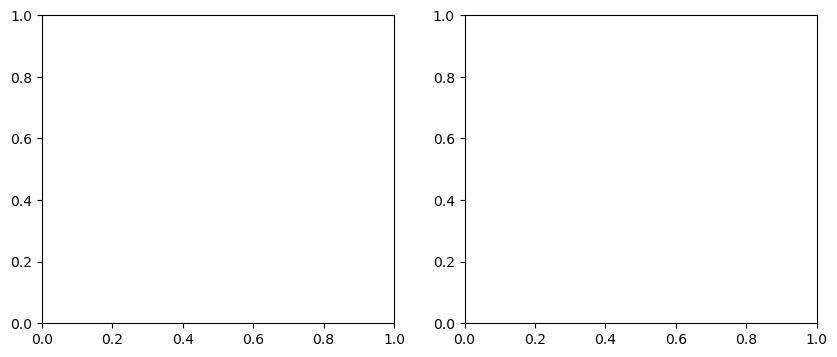

In [18]:
groups = [['gender','age','race']]
fig, axes = plt.subplots(1,2, figsize=(10, 4))  # Set the figure size
for i, profession in enumerate(['firefighter','CEO']):
    for fc in function_classes:
        config['functionclass'] = fc    
        cmap = color_palettes[fc]
        for j, group in enumerate(groups):
            config['group'] = group
            color_intensity = (j + 1) / len(groups)
            color = cmap(color_intensity)
            label = f'{fc} {group_name[tuple(group)]}'
            axes[i].plot(MPR_results_onehot[fc][tuple(group)][profession].keys(), MPR_results_onehot[fc][tuple(group)][profession].values(),
             marker='o', linestyle='--', label=label+' onehot', color=color)  # Plot Pool Size vs. MPR
            axes[i].plot(MPR_results[fc][tuple(group)][profession].keys(), MPR_results[fc][tuple(group)][profession].values(),
             marker='o', label=label+' soft', color=color)
    axes[i].set_title(profession)  # Add a title
    axes[i].set_xlabel('# of generations')  # Label the x-axis
    axes[i].set_ylabel('MPR')  # Label the yaxis
    axes[i].grid(True)  # Add a grid
    axes[i].legend()
    # axes[i].set_xscale('log')
    axes[i].set_ylim(0,1)
fig.suptitle('MPR values according to # of generations')  # Add a title
fig.show()  # Display the plots

# MPRs of MAPR with the number of pool size given a fixed k

## SD_14

In [ ]:
config = {
    'date' : '070324',
    'query_dataset' : 'stable_bias_large',
    'target_model' : 'SD_14',
    'functionclass' : 'linear',
    'retrieve':True,
    'retriever':'mapr',
    'k' : 20
    # 'target_profession' : 'firefighter', 
    # 'pool_size' : [0.002, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]#, 0.7, 0.8, 0.9, 1.0]
}

runs_df = load_config()

param_name = 'pool_size'
pool_sizes =  [0.002, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]


prorfessions = ['firefighter','CEO']
MPR_results = {}
idxs_results = {}
scores_results = {}
for profession in prorfessions:
    config['target_profession'] = profession
    df = filter_results_df(runs_df, config)
    filename_dic = extract_filename(df, param_name, pool_sizes)    
    MPR_results[profession] = {}
    idxs_results[profession] = {}
    scores_results[profession] = {}
    for param, filename in filename_dic.items():
        with open(filename+'_MPR.pkl', 'rb') as f:
            print(f'{filename} is loaded for the result of {param_name} = {param}')
            MPR_results[profession][param] = pickle.load(f)[profession]
        with open(filename+'_score.pkl', 'rb') as f:
            scores_results[profession][param] = pickle.load(f)[profession]
        with open(filename+'_idx.pkl', 'rb') as f:
            idxs_results[profession][param] = pickle.load(f)[profession]

# df['config']['pool_size']


Found 14 matching runs
070324/0045_007ff2ko is loaded for the result of pool_size = 0.002
070324/0048_d7mjfxtm is loaded for the result of pool_size = 0.005
070324/0050_ffhamu1e is loaded for the result of pool_size = 0.01
070324/0052_85tzu90n is loaded for the result of pool_size = 0.05
070324/0054_msswljxf is loaded for the result of pool_size = 0.1
070324/0057_9a0h068s is loaded for the result of pool_size = 0.2
070324/0100_qcjnr5eq is loaded for the result of pool_size = 0.3
070324/0104_u7h9m309 is loaded for the result of pool_size = 0.4
070324/0109_6ah6mufh is loaded for the result of pool_size = 0.5
070324/0114_h92m8wnv is loaded for the result of pool_size = 0.6
070324/0119_e4ojm1u9 is loaded for the result of pool_size = 0.7
070324/0126_wb7ks5q0 is loaded for the result of pool_size = 0.8
070324/0133_1friupyf is loaded for the result of pool_size = 0.9
070324/0140_kxj66qeq is loaded for the result of pool_size = 1.0
Found 14 matching runs
070324/0046_ter9ueyc is loaded for the

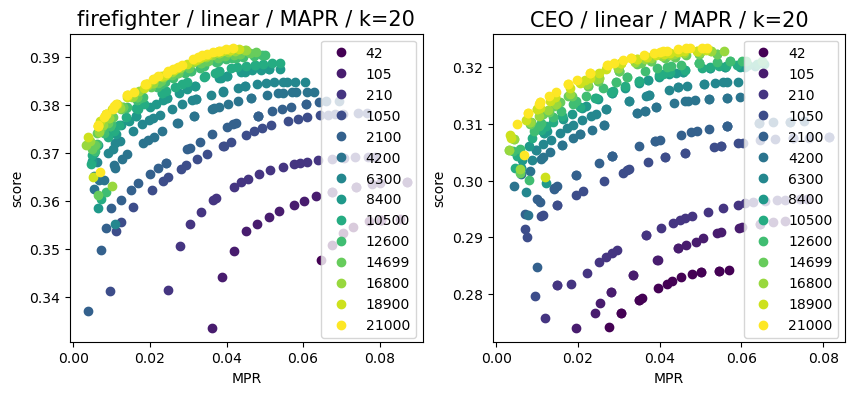

In [ ]:

fig, axs = plt.subplots(1,2, figsize=(10, 4))
norm = plt.Normalize(1, len(pool_sizes))
cmap = plt.get_cmap('viridis')  # Choose a colormap

for k, profession in enumerate(prorfessions):
    ax = axs[k]
    for i, param in enumerate(pool_sizes):
        color = cmap(norm(i+1))
        flag = 0
        # for j, mpr in enumerate(MPRs[profession][i]):
        #     if j == 0:
        #         continue
        #     if (mpr-0.02) < MPRs[i]['firefighter'][j-1]:
        #         flag = j-1
        # print(flag)
        x,y = MPR_results[profession][param], scores_results[profession][param]
        x, y = np.array(x), np.array(y)
        ax.plot(x,y/20, 'o', label=f'{int(param*21000)}', color=color)
        # ax.set_xlim(0, 0.09)
        # ax.set_ylim(3.5,7)
        ax.set_xlabel('MPR')
        ax.set_ylabel('score')
        ax.legend()
    # ax.invert_yaxis()
        ax.set_title(f'{profession} / linear / MAPR / k=20', fontsize=15)

plt.show()

['0.png' '1.png' '2.png' ... '20997.png' '20998.png' '20999.png']
21000
dict_keys([0.002, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0])


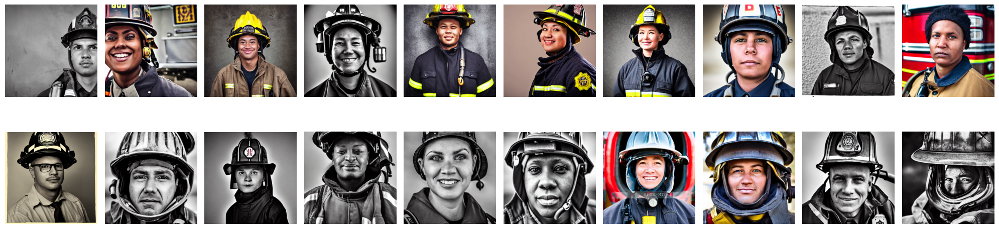

In [ ]:
import os
profession = 'firefighter'
path = f'/n/holyscratch01/calmon_lab/Lab/datasets/SD_14/{profession}'
filenames = os.listdir(path)
filenames = np.array(filenames)
filenames_id = [int(f.split('.')[0]) for f in filenames]
filenames_id = np.argsort(filenames_id)
filenames = filenames[filenames_id]
# filenames = filenames[:15000]
print(filenames)

profession_set = [profession]
print(len(filenames))
# filename = self.filenames[idx]
# imagepath = os.path.join(self.path, filename)
# image = Image.open(imagepath).convert("RGB")


fig, axs = plt.subplots(2, 10, figsize=(20, 6))
print(idxs_results['firefighter'].keys())
idxs = idxs_results['firefighter'][1.0]
for i, idx in enumerate(idxs.nonzero()[0]):
    imagepath = filenames[idx]
    imagepath = os.path.join(path,imagepath)
    img = mpimg.imread(imagepath)  # Read the image from the file
    ax = axs[i // 10, i % 10]  # Determine the row and column of the subplot
    ax.imshow(img)  # Display the image
    ax.axis('off')  # Hide the axes
plt.tight_layout()
# fig.suptitle(f'{profession} images by KNN')
plt.show()

In [78]:
config = {
    'date' : '070324',
    'query_dataset' : 'stable_bias_large',
    'target_model' : 'SD_14',
    'functionclass' : 'dt',
    'retrieve':True,
    'retriever':'mapr',
    'k' : 20
    # 'target_profession' : 'firefighter', 
    # 'pool_size' : [0.002, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]#, 0.7, 0.8, 0.9, 1.0]
}

runs_df = load_config()

param_name = 'pool_size'
pool_sizes =  [0.002, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]


prorfessions = ['firefighter','CEO']
MPR_results = {}
idxs_results = {}
scores_results = {}
for profession in prorfessions:
    config['target_profession'] = profession
    df = filter_results_df(runs_df, config)
    filename_dic = extract_filename(df, param_name, pool_sizes)    
    MPR_results[profession] = {}
    idxs_results[profession] = {}
    scores_results[profession] = {}
    for param, filename in filename_dic.items():
        with open(filename+'_MPR.pkl', 'rb') as f:
            print(f'{filename} is loaded for the result of {param_name} = {param}')
            MPR_results[profession][param] = pickle.load(f)[profession]
        with open(filename+'_score.pkl', 'rb') as f:
            scores_results[profession][param] = pickle.load(f)[profession]
        with open(filename+'_idx.pkl', 'rb') as f:
            idxs_results[profession][param] = pickle.load(f)[profession]

# df['config']['pool_size']


Found 14 matching runs
070324/0046_p3lyfb62 is loaded for the result of pool_size = 0.002
070324/0101_3g0h4ole is loaded for the result of pool_size = 0.005
070324/0120_nz6n6a64 is loaded for the result of pool_size = 0.01
070324/0152_7ks08c1w is loaded for the result of pool_size = 0.05
070324/0224_rctybw1i is loaded for the result of pool_size = 0.1
070324/0304_7x039b65 is loaded for the result of pool_size = 0.2
070324/0348_1kyj5rj8 is loaded for the result of pool_size = 0.3
070324/0449_si0nrxcr is loaded for the result of pool_size = 0.4
070324/0555_8vym7pw9 is loaded for the result of pool_size = 0.5
070324/0705_35bzhndn is loaded for the result of pool_size = 0.6
070324/0820_tsikytkg is loaded for the result of pool_size = 0.7
070324/1113_q6wknnqz is loaded for the result of pool_size = 0.8
070324/1225_em1m6i05 is loaded for the result of pool_size = 0.9
070324/1331_pu5ffaes is loaded for the result of pool_size = 1.0
Found 14 matching runs
070324/0046_5x0yhv8k is loaded for the

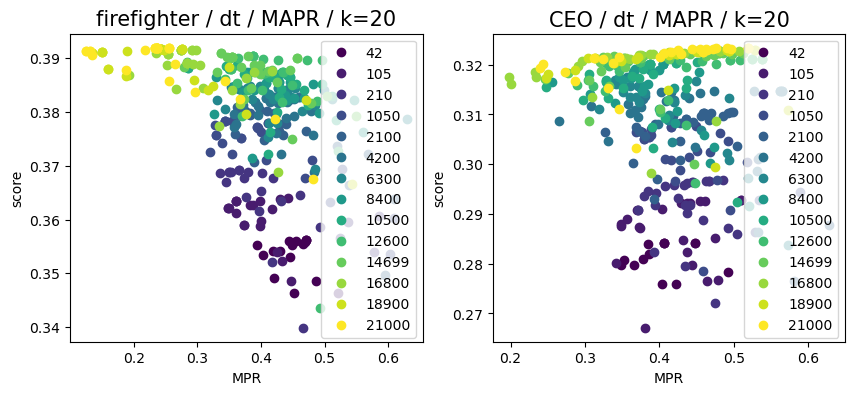

In [81]:

fig, axs = plt.subplots(1,2, figsize=(10, 4))
norm = plt.Normalize(1, len(pool_sizes))
cmap = plt.get_cmap('viridis')  # Choose a colormap

for k, profession in enumerate(prorfessions):
    ax = axs[k]
    for i, param in enumerate(pool_sizes):
        color = cmap(norm(i+1))
        flag = 0
        # for j, mpr in enumerate(MPRs[profession][i]):
        #     if j == 0:
        #         continue
        #     if (mpr-0.02) < MPRs[i]['firefighter'][j-1]:
        #         flag = j-1
        # print(flag)
        x,y = MPR_results[profession][param], scores_results[profession][param]
        x, y = np.array(x), np.array(y)
        ax.plot(x,y/20, 'o', label=f'{int(param*21000)}', color=color)
        # ax.set_xlim(0, 0.09)
        # ax.set_ylim(3.5,7)
        ax.set_xlabel('MPR')
        ax.set_ylabel('score')
        ax.legend()
    # ax.invert_yaxis()
        ax.set_title(f'{profession} / dt / MAPR / k=20', fontsize=15)

plt.show()

['0.png' '1.png' '2.png' ... '20997.png' '20998.png' '20999.png']
21000
dict_keys([0.002, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0])
0.48237348237638156


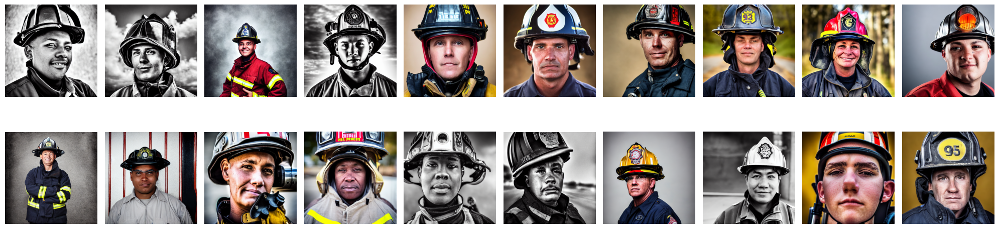

In [221]:
import os
profession = 'firefighter'
path = f'/n/holyscratch01/calmon_lab/Lab/datasets/SD_14/{profession}'
filenames = os.listdir(path)
filenames = np.array(filenames)
filenames_id = [int(f.split('.')[0]) for f in filenames]
filenames_id = np.argsort(filenames_id)
filenames = filenames[filenames_id]
# filenames = filenames[:15000]
print(filenames)

profession_set = [profession]
print(len(filenames))
# filename = self.filenames[idx]
# imagepath = os.path.join(self.path, filename)
# image = Image.open(imagepath).convert("RGB")


fig, axs = plt.subplots(2, 10, figsize=(20, 6))
print(idxs_results['firefighter'].keys())
idxs = idxs_results['firefighter'][1.0]
print(MPR_results['firefighter'][1.0][-1])
for i, idx in enumerate(idxs.nonzero()[0]):
    imagepath = filenames[idx]
    imagepath = os.path.join(path,imagepath)
    img = mpimg.imread(imagepath)  # Read the image from the file
    ax = axs[i // 10, i % 10]  # Determine the row and column of the subplot
    ax.imshow(img)  # Display the image
    ax.axis('off')  # Hide the axes
plt.tight_layout()
# fig.suptitle(f'{profession} images by KNN')
plt.show()

# Compare performances of MAPR and fairdiffusion

In [6]:
from collections import defaultdict
def rec_dd():
    return defaultdict(rec_dd)
MPR_results = rec_dd()
scores_results = rec_dd()

In [17]:
method_list = ['fairdiffusion', 'uce','mapr' ]
profession_list = ['firefighter']#, 'CEO']
group_list = [('gender',),('gender','age','race')]
fc_list = ['linear','boolean2','boolean3']

In [18]:
t = tuple(['gender', 'age','race'])
t = tuple(['gender'])
print(t)
for g in group_list:
    print([g])

('gender',)
[('gender',)]
[('gender', 'age', 'race')]


### Fairdiffusion

In [22]:

config = {
    'date' : '072224',
    'query_dataset' : 'general',
    'target_model' : 'SD_14',
    'trainer' : 'fairdiffusion',
    'trainer_group' : ['gender']
    # 'functionclass' : 'linear',
    # 'retrieve':True,
    # 'retriever':'mapr',
}

runs_df = load_config()
trainer = 'fairdiffusion'

for group in group_list:
    for profession in profession_list:
        for fc in fc_list:
            config['mpr_group'] = list(group)
            config['functionclass'] = fc
            # config['functionclass'] = fc
            config['target_profession'] = profession
            print(config['functionclass'], profession)
            df = filter_results_df(runs_df, config)
            filename_dic = extract_filename(df)    
            for key, value in filename_dic.items():
                with open(value+'_MPR.pkl', 'rb') as f:
                    print(f'{value} is loaded')
                    _result = pickle.load(f)
                    print(_result)
                    try:
                        MPR_results[trainer][group][profession][fc] = _result[profession]
                    except:
                        MPR_results[trainer][group][profession][fc] = _result
                with open(value+'_score.pkl', 'rb') as f:
                    _result = pickle.load(f)
                    try:
                        scores_results[trainer][group][profession][fc] = _result[profession]
                    except:
                        scores_results[trainer][group][profession][fc] = _result
            # with open(filename+'_idx.pkl', 'rb') as f:
                # idxs_results[profession][param] = pickle.load(f)[profession]

    # df['config']['pool_size']


linear firefighter
Found 1 matching runs
072224/1128_qk0kwpa0 is loaded
{'firefighter': [0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695, 0.13466059501009695]}
boolean2 firefighter
Found 1 matching runs
072224/1323_zj5tm66r is loaded
{'firefighter': []}
boolean3 firefighter
Found 1 matching runs
072224/1326_k4lw0vhb is loaded
{'firefighter': []}
linear firefighter
Found 1 matching runs
072224/1129_9aigvmuq is loaded
{'firefighter': [1.0

In [21]:
MPR_results

defaultdict(<function __main__.rec_dd()>,
            {'fairdiffusion': defaultdict(<function __main__.rec_dd()>,
                         {('gender',): defaultdict(<function __main__.rec_dd()>,
                                      {'firefighter': defaultdict(<function __main__.rec_dd()>,
                                                   {'linear': [0.13466059501009695,
                                                     0.13466059501009695,
                                                     0.13466059501009695,
                                                     0.13466059501009695,
                                                     0.13466059501009695,
                                                     0.13466059501009695,
                                                     0.13466059501009695,
                                                     0.13466059501009695,
                                                     0.13466059501009695,
                                 

### UCE

In [23]:

config = {
    'date' : '072224',
    'query_dataset' : 'general',
    'target_model' : 'SD_14',
    'trainer' : 'uce',
    
    # 'functionclass' : 'linear',
    # 'retrieve':True,
    # 'retriever':'mapr',
}
trainer = config['trainer']
runs_df = load_config()

for group in group_list:
    for profession in profession_list:
        for fc in fc_list:
            config['functionclass'] = fc
            config['target_profession'] = profession
            config['group'] = list(group)
            print(config['group'])
            print(config['functionclass'], profession)
            df = filter_results_df(runs_df, config)
            filename_dic = extract_filename(df)    
            for key, value in filename_dic.items():
                with open(value+'_MPR.pkl', 'rb') as f:
                    print(f'{value} is loaded')
                    MPR_results[trainer][group][profession][fc] = pickle.load(f)[profession]
                with open(value+'_score.pkl', 'rb') as f:
                    scores_results[trainer][group][profession][fc] = pickle.load(f)[profession]
        # with open(filename+'_idx.pkl', 'rb') as f:
            # idxs_results[profession][param] = pickle.load(f)[profession]

# df['config']['pool_size']


['gender']
linear firefighter
Found 0 matching runs
['gender']
boolean2 firefighter
Found 0 matching runs
['gender']
boolean3 firefighter
Found 0 matching runs
['gender', 'age', 'race']
linear firefighter
Found 0 matching runs
['gender', 'age', 'race']
boolean2 firefighter
Found 0 matching runs
['gender', 'age', 'race']
boolean3 firefighter
Found 0 matching runs


In [22]:
config = {
    'date' : '071724',
    'query_dataset' : 'general',
    'target_model' : 'SD_14',
    # 'functionclass' : 'linear',
    # 'retrieve':True,
    'retriever':'mapr',
    'k' : 10000,
    'target_profession' : 'firefighter', 
    # 'pool_size' : [0.002, 0.005, 0.01, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]#, 0.7, 0.8, 0.9, 1.0]
}

runs_df = load_config()
profession = 'firefighter'
function_classes = ['linear','dt']
group = ('gender','age','race')

for fc in function_classes:
    config['functionclass'] = fc
    df = filter_results_df(runs_df, config)
    filename_dic = extract_filename(df)    
    for key, value in filename_dic.items():
        # with open(value+'_MPR.pkl', 'rb') as f:
            
            # MPR_results['mapr'][group][profession][fc] = pickle.load(f)[profession]
        with open(value+'_norMPR.pkl', 'rb') as f:
            print(f'{value} is loaded')
            MPR_results['mapr'][group][profession][fc] = np.array(pickle.load(f)[profession])
        with open(value+'_score.pkl', 'rb') as f:
            scores_results['mapr'][group][profession][fc] = np.array(pickle.load(f)[profession])
# df['config']['pool_size']

Found 1 matching runs
071724/1625_lrpa6fwf is loaded


KeyError: 'mapr'

In [ ]:
color_dic = {
    'mapr' : 'blue',
    'fairdiffusion' : 'red',
    'uce' : 'green'
}

NameError: name 'method_list' is not defined

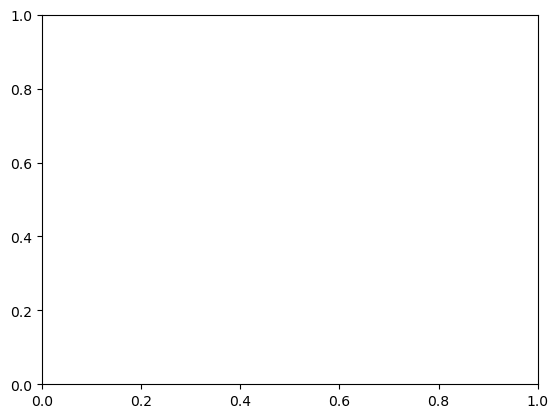

In [23]:
fig, ax = plt.subplots()
group = ('gender','age','race')

for method in method_list:
    for group in group_list:
        print(method, group)
        if method == 'mapr' and len(group) < 3:
            continue
        postfix = '(G/A/R)' if len(group) == 3 else '(G)'
        x = MPR_results[method][group]['firefighter']['linear']
        y = scores_results[method][group]['firefighter']['linear']/10000
        if method == 'mapr':
            ax.plot(x, y, 'o', label='mapr', color=color_dic[method])
        else:
            linestyle = '-' if len(group) == 3 else '--'
            ax.hlines(y, x-0.01, x+0.01, linestyle=linestyle, color=color_dic[method],label=f'{method} {postfix}')  # Draw horizontal line
            ax.vlines(x, y-0.002, y+0.002, linestyle=linestyle, color=color_dic[method])  

        # x,y = fdg_MPR_results[profession]['linear'], fdg_scores_results[profession]['linear']['firefighter']/10000
        # ax.hlines(y, x-0.01, x+0.01, color='orange',label='fairdiffusion (G)')  # Draw horizontal line
        # ax.vlines(x, y-0.002, y+0.002, color='orange') 

ax.set_xlabel('MPR')
ax.set_ylabel('score')
ax.legend()
# ax.invert_yaxis()
ax.set_title(profession, fontsize=15)
plt.show()

## Fairdiffusion samples

In [8]:
with open('../fd_samples.pkl', 'rb') as f:
    fd_samples = pickle.load(f)
print(len(fd_samples['male young East Asian']))

5


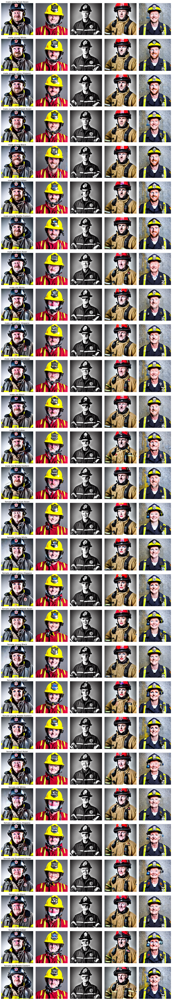

In [14]:
# Assuming `fd_samples` is your dictionary with identities as keys and lists of images as values
identities = list(fd_samples.keys())  # Select the first 28 identities for demonstration

fig, axs = plt.subplots(len(identities), 5, figsize=(15, 3*len(identities)))  # Adjust figure size as needed

for i, identity in enumerate(identities):
    images = fd_samples[identity]  # Select up to 5 images for this identity
    for j, img in enumerate(images):
        axs[i, j].imshow(img)  # Display the image
        axs[i, j].axis('off')  # Hide axis for cleaner look
        if j == 0:  # Add identity text below the first image of each row
            axs[i, j].set_title(identity, pad=3)

plt.subplots_adjust(wspace=0, hspace=0.2) 
plt.tight_layout()  # Adjust layout to make room for titles if necessary
plt.show()  # Display the plot
fig.savefig('identity_images.png', dpi=300)  # Save as PNG with high resolution
